In [1]:
import os
from pathlib import Path

os.chdir(Path(os.getcwd()).parents[2])
os.getcwd()

target = "mth" # mth, pce

In [2]:
import torch
import torch.nn as nn
import numpy as np
import kaleido
from torch.utils.data import DataLoader
from data.perovskite_dataset import (
    PerovskiteDataset1d,
    PerovskiteDataset2d,
    PerovskiteDataset3d,
    PerovskiteDataset2d_time,
)
from models.resnet import ResNet152, ResNet, BasicBlock, Bottleneck
from models.slowfast import SlowFast
from data.augmentations.perov_1d import normalize
from data.augmentations.perov_2d import normalize as normalize_2d
from data.augmentations.perov_3d import normalize as normalize_3d
from base_model import seed_worker
from argparse import ArgumentParser
from os.path import join

data_dir = "/home/l727n/Projects/Applied Projects/ml_perovskite/preprocessed"

if target == "pce":
    checkpoint_dir = "/home/l727n/E132-Projekte/Projects/Helmholtz_Imaging_ACVL/KIT-FZJ_2021_Perovskite/data_Jan_2022/checkpoints"

    path_to_checkpoint = join(
        checkpoint_dir, "1D-epoch=999-val_MAE=0.000-train_MAE=0.490.ckpt"
    )
else:
    checkpoint_dir = "/home/l727n/E132-Projekte/Projects/Helmholtz_Imaging_ACVL/KIT-FZJ_2021_Perovskite/data_Jan_2022/mT_checkpoints/checkpoints"

    path_to_checkpoint = join(
        checkpoint_dir, "mT_1D_RN152_full-epoch=999-val_MAE=0.000-train_MAE=40.332.ckpt"
    )


/home/l727n/miniconda3/envs/perovskite/lib/python3.9/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
#### 1D Model (no border)

hypparams = {
    "dataset": "Perov_1d",
    "dims": 1,
    "bottleneck": False,
    "name": "ResNet152",
    "data_dir": data_dir,
    "no_border": False,
    "resnet_dropout": 0.0,
    "stochastic_depth": 0.0,
    "norm_target": True if target == "pce" else False,
    "target": "PCE_mean" if target == "pce" else "meanThickness"
}

model = ResNet.load_from_checkpoint(
    path_to_checkpoint,
    block=BasicBlock,
    num_blocks=[4, 13, 55, 4],
    num_classes=1,
    hypparams=hypparams,
)

print("Loaded")
model.eval()

dataset = PerovskiteDataset1d(
    data_dir,
    transform=normalize(model.train_mean, model.train_std),
    scaler=model.scaler,
    no_border=False,
    return_unscaled= False if target == "pce" else True,
    label="PCE_mean" if target == "pce" else "meanThickness",
)

batch_size = 64

loader = DataLoader(
    dataset,
    batch_size=batch_size,
    shuffle=True,
    num_workers=8,
    pin_memory=True,
    worker_init_fn=seed_worker,
    persistent_workers=True,
)

tensor([0.2697, 0.0191, 0.0057, 0.0216]) tensor([0.1589, 0.0106, 0.0030, 0.0145])
Loaded


In [4]:
# Select batch

x_batch = next(iter(DataLoader(
    dataset,
    batch_size=len(dataset),
    shuffle=True,
    num_workers=8,
    pin_memory=True,
    worker_init_fn=seed_worker,
    persistent_workers=True,
)))

with torch.no_grad():
    y_batch = model.predict(x_batch).flatten()

x_batch = x_batch[0]

In [27]:
val_max , pos_max = x_batch.max(2)
val_min , pos_min = x_batch.min(2)

val_mean = x_batch.mean((0,2))

x_batch_low = x_batch[y_batch < 10.5] if target == "pce" else x_batch[y_batch < 700]
x_batch_high = x_batch[y_batch > 13.5] if target == "pce" else x_batch[y_batch > 900]

n_samples = [len(x_batch_low), len(x_batch_high)]


In [28]:
### Generate Concepts

import plotly.graph_objects as go
from plotly.subplots import make_subplots


def format_title(title, subtitle=None, font_size=14, subtitle_font_size=14):
    title = f'<span style="font-size: {font_size}px;"><b>{title}</b></span>'
    if not subtitle:
        return title
    subtitle = f'<span style="font-size: {subtitle_font_size}px;">{subtitle}</span>'
    return f"{title}<br>{subtitle}"

fig = make_subplots(
    rows=4,
    cols=3,
    specs=[
        [{}, {"rowspan": 2}, {"rowspan": 2}],
        [{}, None, None],
        [{}, {"rowspan": 2}, {"rowspan": 2}],
        [{}, None, None],
    ],
    column_widths=[0.1, 0.45, 0.45],
    subplot_titles=(
        format_title("Global Slope", "Downwards Slope",),
        format_title("High PCE Samples (n=" + str(len(x_batch_high)) + ")" if target == "pce" else "Thick mTh Samples (n=" + str(len(x_batch_high)) + ")", " ",),
        format_title("Low PCE Samples (n=" + str(len(x_batch_low)) + ")" if target == "pce" else "Thin mTh Samples (n=" + str(len(x_batch_low)) + ")", " ",),
        format_title("", "Upwards Slope",),
        format_title("Peak Position", "Early Peak",),
        None,
        None,
        format_title("", "Late Peak",),
        None,
        None,
    ),
)

color = ["#E1462C", "#0059A0", "#5F3893", "#FF8777","#0A2C6E", "#CEDEEB"]
wave = ["ND", "LP725", "LP780", "SP775"]

x = np.arange(start=0, stop=719, step=1)

n_data = len(x)
n_rnd = 100

## Downwards slope

m_loc = [0.001, 0.0025, 0.002, 0.002] 
y_downwards = []

for i in range(4):
    m = np.random.normal(loc=m_loc[i], scale=0.2 * m_loc[i], size=n_rnd)

    b_loc = val_max.mean(0)[i] - (val_max.mean(0)[i] / 3)
    b = np.random.normal(loc=b_loc, scale=0.25 * b_loc, size=n_rnd)

    y_downwards.append((b - m * x[:, np.newaxis]).transpose())

    for val in y_downwards[i]:
        fig.add_trace(
            go.Scatter(
                y=val,
                name=wave[i],
                marker_color=color[i],
                opacity=0.1,
                showlegend=False,
            ),
            row=1,
            col=1,
        )

y_downwards = torch.tensor(np.asarray(y_downwards).transpose((1, 0, 2)))

## Upward slope

m_loc = [0.001, 0.0025, 0.002, 0.002]
y_upwards = []

for i in range(4):
    m = np.random.normal(loc=m_loc[i], scale=0.2 * m_loc[i], size=n_rnd)

    b_loc = val_min.mean(0)[i] - (val_min.mean(0)[i] / 3)
    b = np.random.normal(loc=b_loc, scale=0.25 * b_loc.abs(), size=n_rnd)

    y_upwards.append((b + m * x[:, np.newaxis]).transpose())

    for val in y_upwards[i]:
        fig.add_trace(
            go.Scatter(
                y=val,
                name=wave[i],
                marker_color=color[i],
                opacity=0.1,
                showlegend=False,
            ),
            row=2,
            col=1,
        )

y_upwards = torch.tensor(np.asarray(y_upwards).transpose((1, 0, 2)))

## Early Peak
from scipy.signal import resample

y_early = []

for i in range(4):
    x_pos = np.random.randint(2, 6, size=n_rnd)
    peak_loc = val_max.mean(0)[i] - (val_max.mean(0)[i] / 2.5)
    peak = np.random.normal(loc=peak_loc, scale=0.25 * peak_loc.abs(), size=n_rnd)

    y = np.zeros((n_rnd, 20))
    y[np.arange(0, 100), x_pos] = peak
    y_res = resample(y, 719, axis=1)
    y_res[:, 400:] = 0
    y_early.append(y_res)

    for val in y_early[i]:
        fig.add_trace(
            go.Scatter(
                y=val,
                name=wave[i],
                marker_color=color[i],
                opacity=0.1,
                showlegend=False,
            ),
            row=3,
            col=1,
        )

y_early = torch.tensor(np.asarray(y_early).transpose((1, 0, 2)))

## Late Peak
from scipy.signal import resample

y_late = []

for i in range(4):
    x_pos = np.random.randint(17, 20, size=n_rnd)
    peak_loc = val_max.mean(0)[i] - (val_max.mean(0)[i] / 2.5)
    peak = np.random.normal(loc=peak_loc, scale=0.25 * peak_loc.abs(), size=n_rnd)

    y = np.zeros((n_rnd, 20))
    y[np.arange(0, 100), x_pos] = peak
    y_res = resample(y, 719, axis=1)
    y_res[:, 0:400] = 0
    y_late.append(y_res)

    for val in y_late[i]:
        fig.add_trace(
            go.Scatter(
                y=val,
                name=wave[i],
                marker_color=color[i],
                opacity=0.1,
                showlegend=False,
            ),
            row=4,
            col=1,
        )

y_late = torch.tensor(np.asarray(y_late).transpose((1, 0, 2)))


In [29]:
import torch.utils.data as data_utils
from captum.concept import Concept, TCAV, ConceptInterpreter
from captum.attr import LayerGradientXActivation, LayerIntegratedGradients, LayerGradientShap

def collate_fn(batch):
    batch = torch.cat([sample[0].unsqueeze(0) for sample in batch], dim=0)
    return batch.float()

y_downwards_train = data_utils.TensorDataset(y_downwards)
y_downwards_loader = data_utils.DataLoader(y_downwards_train, batch_size=30, shuffle=True, collate_fn=collate_fn)

y_upwards_train = data_utils.TensorDataset(y_upwards)
y_upwards_loader = data_utils.DataLoader(y_upwards_train, batch_size=30, shuffle=True, collate_fn=collate_fn)

y_early_train = data_utils.TensorDataset(y_early)
y_early_loader = data_utils.DataLoader(y_early_train, batch_size=30, shuffle=True, collate_fn=collate_fn)

y_late_train = data_utils.TensorDataset(y_late)
y_late_loader = data_utils.DataLoader(y_late_train, batch_size=30, shuffle=True, collate_fn=collate_fn)

y_random_train = data_utils.TensorDataset(x_batch)
y_random_loader = data_utils.DataLoader(y_random_train, batch_size=30, shuffle=True, collate_fn=collate_fn)

concept_random = Concept(0, "random", y_random_loader)
concept_random_2 = Concept(1, "random_2", y_random_loader)
concept_downwards = Concept(2, "Downwards Slope", y_downwards_loader)
concept_upwards = Concept(3, "Upwards Slope", y_upwards_loader)
concept_early = Concept(4, "Early Peak", y_early_loader)
concept_late = Concept(5, "Late Peak", y_late_loader)

layers = ['layer3.0.conv1', 'layer3.1.conv1', 'layer3.2.conv1', 'layer3.3.conv1', 'layer4.0.conv1', 'layer4.1.conv1', 'layer4.2.conv1', 'layer4.3.conv1'
]
mytcav = TCAV(model=model, layers=layers#, layer_attr_method = LayerIntegratedGradients(model, None, multiply_by_inputs=False)
)

experiments = [[concept_upwards, concept_downwards],[concept_early, concept_late]#, [concept_random, concept_random_2]
]

scores_high = mytcav.interpret(x_batch_high, experiments#, n_steps = 10
)

scores_low = mytcav.interpret(x_batch_low, experiments#, n_steps = 10
)

/home/l727n/miniconda3/envs/perovskite/lib/python3.9/site-packages/captum/concept/_utils/classifier.py:130: UserWarning:

Using default classifier for TCAV which keeps input both train and test datasets in the memory. Consider defining your own classifier that doesn't rely heavily on memory, for large number of concepts, by extending `Classifer` abstract class



In [30]:
### Plot TCAV results
from captum.concept._utils.common import concepts_to_str
from statsmodels.stats.proportion import proportions_ztest

idx = 1
loop = 0
for score in (scores_low, scores_high):
    idx += 1

    for idx_es, concepts in enumerate(experiments):
        concepts = experiments[idx_es]
        concepts_key = concepts_to_str(concepts)

        val_c1 = [
            scores["sign_count"][0] for layer, scores in score[concepts_key].items()
        ]
        val_c2 = [
            scores["sign_count"][1] for layer, scores in score[concepts_key].items()
        ]

        val_c1_prob = np.round(np.multiply(val_c1, n_samples[idx-2]))

        prop_ztest = []
        for i in range(len(val_c1)):
            prop_ztest.append(
                proportions_ztest(
                    count=np.array([val_c1_prob, n_samples[idx-2] - val_c1_prob])[:, i],
                    nobs=n_samples[idx-2],
                )[1]
                >= 0.05
            )

        if idx_es == 0:
            n_row = idx_es + 1
        else:
            n_row = idx_es + 2

        fig.add_trace(
            go.Bar(
                x=[layer.replace(".conv1", "") for layer in layers],
                y=val_c1,
                name=concepts[0].name,
                marker_color=color[1],
                opacity=1,
                showlegend=True if idx == 3 else False,
                legendgroup=concepts[0].name,
                # text = np.where(np.array(prop_ztest) == True, "ns", " "),
                textposition="outside",
            ),
            row=n_row,
            col=idx,
        )

        fig.add_trace(
            go.Bar(
                x=[layer.replace(".conv1", "") for layer in layers],
                y=val_c2,
                name=concepts[1].name,
                marker_color=color[5],
                # opacity= 0.8,
                showlegend=True if idx == 3 else False,
                legendgroup=concepts[0].name,
            ),
            row=n_row,
            col=idx,
        )

        y_pos = (
            torch.stack([torch.tensor(val_c1), torch.tensor(val_c2)])
            .max(0)
            .values.numpy()[np.argwhere(np.array(prop_ztest))]
        )  # https://i.kym-cdn.com/entries/icons/original/000/034/623/Untitled-3.png
        x_pos = np.argwhere(np.array(prop_ztest))

        ref_x = ["x2", "x6", "x3", "x7"]
        ref_y = ["y2", "y6", "y3", "y7"]

        for i in range(len(y_pos)):
            fig.add_annotation(
                x=x_pos[i][0],
                y=y_pos[i][0] + 0.05,
                showarrow=False,
                xref=ref_x[loop],
                yref=ref_y[loop],
                text="ns",
            )

        loop += 1

### Plot

fig.update_yaxes(title=None, showticklabels=False, zeroline=False, col=1)
fig.update_xaxes(title=None, showticklabels=False, zeroline=False, col=1)

fig.update_yaxes(
    title="% Sign Test", title_standoff=0, range=[0, 1.01], showgrid=True, col=2
)
fig.update_xaxes(tickfont=dict(size=10), col=2)

fig.update_xaxes(title="Tested Layers", col=2, row=3)
fig.update_xaxes(title="Tested Layers", col=3, row=3)

fig.update_yaxes(showticklabels=False,range=[0, 1.01], col=3)
fig.update_xaxes(tickfont=dict(size=10), col=3)

fig.update_layout(
    legend_title="Concepts",
    title_x=0.0625,
    template="plotly_white",
    height=650,
    width=1200,
    legend_tracegroupgap=210,
)

fig.write_image("xai/images/"+ target + "/1D/1D_tcav.png", scale=2)

fig.show()


In [23]:
import matplotlib.pyplot as plt
from captum.concept._utils.common import concepts_to_str

def format_float(f):
    return float('{:.3f}'.format(f) if abs(f) >= 0.0005 else '{:.3e}'.format(f))

def plot_tcav_scores(experimental_sets, tcav_scores):
    fig, ax = plt.subplots(1, len(experimental_sets), figsize = (40, 7))

    barWidth = 1 / (len(experimental_sets[0]) + 1)

    for idx_es, concepts in enumerate(experimental_sets):

        concepts = experimental_sets[idx_es]
        concepts_key = concepts_to_str(concepts)

        pos = [np.arange(len(layers))]
        for i in range(1, len(concepts)):
            pos.append([(x + barWidth) for x in pos[i-1]])
        _ax = (ax[idx_es] if len(experimental_sets) > 1 else ax)
        for i in range(len(concepts)):
            val = [format_float(scores['sign_count'][i]) for layer, scores in tcav_scores[concepts_key].items()]
            _ax.bar(pos[i], val, width=barWidth, edgecolor='white', label=concepts[i].name)

        # Add xticks on the middle of the group bars
        _ax.set_xlabel('Set {}'.format(str(idx_es)), fontweight='bold', fontsize=16)
        _ax.set_xticks([r + 0.3 * barWidth for r in range(len(layers))])
        _ax.set_xticklabels(map(str, layers), fontsize=16)

        # Create legend & Show graphic
        _ax.legend(fontsize=16)

    plt.show()

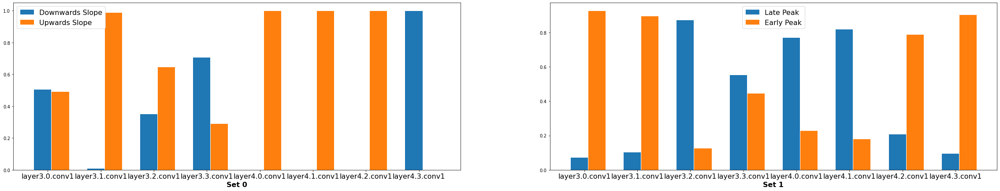

In [33]:
plot_tcav_scores(experiments, scores_high)